In [76]:
import os
from matplotlib import pyplot as plt

from sklearn.decomposition import PCA

from scipy.spatial.distance import squareform
import scipy.cluster

import spyrmsd
from spyrmsd import io, rmsd

import MDAnalysis as mda
from MDAnalysis.coordinates.memory import MemoryReader
from MDAnalysis.analysis import align

import py3Dmol

import ipywidgets as widgets
from ipywidgets import interact, interactive, fixed, interact_manual

# Performing and analyzing a parallel tempering calculation with Fulton Market

In this exercise, we will perform a parallel tempering calculation and some analysis. Parallel tempering is a type of replica exchange in which replicas differ only be temperature. Fulton Market is a package being developed my research group that implements several specific versions of replica exchange. This exercise was designed to be run on the Bridges-2 high performance computing resource.

When you are done, download the document as a ipynb and upload it to your Google Drive for grading. It will be graded as satisfactory or unsatisfactory based on correctly completing the sections after `-->`. Do not remove the symbol `-->`.

# Part 0 - Setting up the required software

Log onto [Bridges-2 OnDemand](https://ondemand.bridges2.psc.edu/pun/sys/dashboard/) and create a shell.

In Exercise 9, we created an environment called OpenMM. We would like to add openmmtools, which includes basic replica exchange capabilities, to this environment. Executing the following code will add the package.

```bash
conda activate OpenMM
conda install -q -y -c conda-forge openmm openmmtools
```

In Exercise 10, we also created an environment called MDAnalysis. We would like to add packages to this environment.

```bash
conda activate MDAnalysis
conda install -q -y -c conda-forge matplotlib seaborn pymbar spyrmsd rdkit
```

Also in Exercise 10, we created a folder called `GitHib` in your home directory. Change to that directory and download Fulton Market by entering `git clone https://github.com/CCBatIIT/FultonMarket.git`. Then to check out a specific version that works with this notebook use `cd FultonMarket` and then `git checkout e18d527`.

Next change to your home directory or `ocean/projects/che240058p/{USERNAME}/exercises/12-Fulton_Market-{SYSTEM_NAME}` and download this notebook using `wget https://raw.githubusercontent.com/daveminh/Chem456-2024F/refs/heads/main/exercises/12-Fulton_Market.ipynb`.

# Part 1 - Running Fulton Market

--> Change the code below to your Bridges-2 user name and receptor-ligand complex system name. When you run the code, you will either print commands to make a directory for this exercise and to change to the directory or actually run the commands on Bridges-2.

In [2]:
USERNAME = 'dminh'
# SYSTEM_NAME = 'ADORA2A-LUF5448'
SYSTEM_NAME = 'ADORA2A-UK432097'

DIR = {'Step_4':f'/ocean/projects/che240058p/{USERNAME}/exercises/08-OpenMM-{SYSTEM_NAME}',
       'Step_5':f'/ocean/projects/che240058p/{USERNAME}/exercises/09-HPC-{SYSTEM_NAME}',
       'OUT':   f'/ocean/projects/che240058p/{USERNAME}/exercises/12-Fulton_Market-{SYSTEM_NAME}'}

if os.path.isdir('/ocean/projects/che240058p/'):
    if not os.path.isdir(DIR['OUT']):
        %mkdir -p {DIR['OUT']}
    %cd {DIR['OUT']}
else:
    print(f"mkdir -p {DIR['OUT']}\ncd {DIR['OUT']}")

/ocean/projects/che240058p/dminh/exercises/12-Fulton_Market-ADORA2A-UK432097


The code below will generate a job script. You can use a text editor such as nano or vim and save it as `{SYSTEM_NAME}_FultonMarket.job`. If you run this code on Bridges-2 it will write the script to the output directory.

In [3]:
FN = {'system_xml': os.path.join(DIR['Step_4'],f'{SYSTEM_NAME}.xml'),
      'state_xml':  os.path.join(DIR['Step_5'],f'Step_5.xml'),
      'pdb':        os.path.join(DIR['Step_5'],f'Step_5.pdb')}

job_script = f"""#!/bin/bash
#SBATCH -p GPU-shared
#SBATCH -t 48:00:00
#SBATCH -N 1
#SBATCH --ntasks=5
#SBATCH --mem=60G
#SBATCH --gpus=v100-32:1
#SBATCH -A che240058p
#SBATCH --mail-type=ALL

#echo commands to stdout
set -x

module load anaconda3
conda activate OpenMM

export PYTHONPATH="/jet/home/{USERNAME}/GitHub/FultonMarket:$PYTHONPATH"

cd '/jet/home/{USERNAME}/GitHub/FultonMarket/'

cat > Parallel_Tempering-{SYSTEM_NAME}.py <<EOF

from FultonMarket.FultonMarket import FultonMarket
market = FultonMarket(\\
  input_system = '{FN['system_xml']}', \\
  input_pdb = '{FN['pdb']}', \\
  input_state = '{FN['state_xml']}', \\
  n_replicates=135)
market.run(\\
  iter_length=0.001, \\
  total_sim_time=500, \\
  sim_length=25, \\
  output_dir='{DIR['OUT']}')

EOF

python Parallel_Tempering-{SYSTEM_NAME}.py
"""

print(job_script)
if os.path.isdir('/ocean/projects/che240058p/'):
    with open(os.path.join(DIR['OUT'], f"{SYSTEM_NAME}_FultonMarket.job"), 'w') as F:
        F.write(job_script)
        F.close()

#!/bin/bash
#SBATCH -p GPU-shared
#SBATCH -t 48:00:00
#SBATCH -N 1
#SBATCH --ntasks=5
#SBATCH --mem=60G
#SBATCH --gpus=v100-32:1
#SBATCH -A che240058p
#SBATCH --mail-type=ALL

#echo commands to stdout
set -x

module load anaconda3
conda activate OpenMM

export PYTHONPATH="/jet/home/dminh/GitHub/FultonMarket:$PYTHONPATH"

cd '/jet/home/dminh/GitHub/FultonMarket/'

cat > Parallel_Tempering-ADORA2A-UK432097.py <<EOF

from FultonMarket.FultonMarket import FultonMarket
market = FultonMarket(\
  input_system = '/ocean/projects/che240058p/dminh/exercises/08-OpenMM-ADORA2A-UK432097/ADORA2A-UK432097.xml', \
  input_pdb = '/ocean/projects/che240058p/dminh/exercises/09-HPC-ADORA2A-UK432097/Step_5.pdb', \
  input_state = '/ocean/projects/che240058p/dminh/exercises/09-HPC-ADORA2A-UK432097/Step_5.xml', \
  n_replicates=135)
market.run(\
  iter_length=0.001, \
  total_sim_time=500, \
  sim_length=25, \
  output_dir='/ocean/projects/che240058p/dminh/exercises/12-Fulton_Market-ADORA2A-UK432097')

EOF



After you have created the file, submit the job using the command `sbatch {SYSTEM_NAME}_FultonMarket.job`. As a reminder, after you submit the job, it will be on the queue until a compute node is available. You will receive emails when the job starts and completes. If your job completes in less than a minute than you probably have done something incorrectly.

In [ ]:
%cd {DIR['OUT']}
!sbatch {SYSTEM_NAME}_FultonMarket.job

As a reminder, you may also use `slurm-tool queue` or [other commands](https://www.psc.edu/resources/bridges-2/user-guide/#batch-jobs) to check your job status.

In [ ]:
!slurm-tool queue

The maximum duration of a job is 48 hours. This calculation will probably take more than 48 hours. Once you receive an email saying that your job is complete, you can log on to Bridges-2 and resubmit the job using the same command. 

In Part 2, we will perform some analysis of this simulation. You can start this analysis once data is saved and before the job is complete.

In [ ]:
%cd {DIR['OUT']}
!ls -ltr

# Part 2 - Analysis of Fulton Market Simulations

For analysis, you should create an interaction session on Bridges2. After it starts, load this notebook with the MDAnalysis kernel.

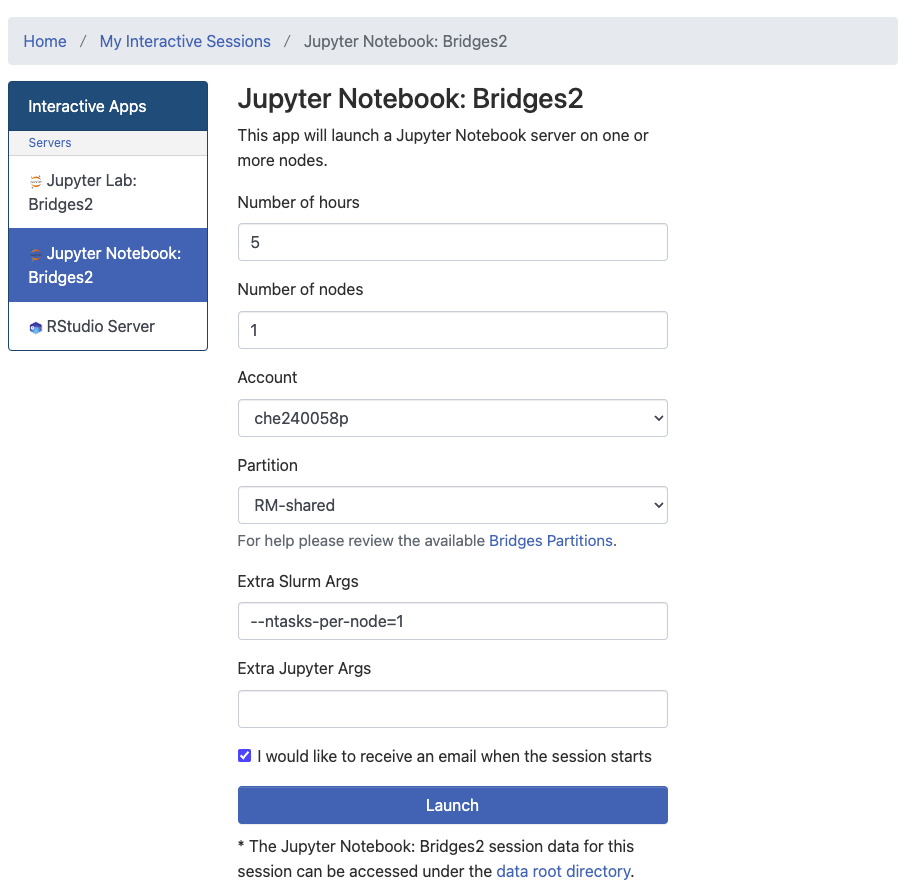

In [ ]:
%cd '/jet/home/{USERNAME}/GitHub/FultonMarket/FultonMarket/'

with open('analysis/FultonMarketAnalysis.py','r') as F:
    dat = F.read()
    F.close()
dat = dat.replace('''        if os.path.exists(all([os.path.join(storage_dir, 'spring_centers.npy') for storage_dir in self.storage_dirs])):
            self.spring_centers_list = [np.load(os.path.join(storage_dir, 'spring_centers.npy'), mmap_mode='r')[skip:] for storage_dir in self.storage_dirs]
            self.spring_centers = self.spring_centers_list[-1]''','''#        if os.path.exists(all([os.path.join(storage_dir, 'spring_centers.npy') for storage_dir in self.storage_dirs])):
#            self.spring_centers_list = [np.load(os.path.join(storage_dir, 'spring_centers.npy'), mmap_mode='r')[skip:] for storage_dir in self.storage_dirs]
#            self.spring_centers = self.spring_centers_list[-1]''')
with open('analysis/FultonMarketAnalysis.py','w') as F:
    F.write(dat)
    F.close()

from analysis.FultonMarketAnalysis import *

fma = FultonMarketAnalysis(DIR['OUT'], pdb = os.path.join(DIR['Step_4'],'Step_4.pdb'))
fma.equilibration_method = 'energy'
fma.resids = None

/jet/home/dminh/GitHub/FultonMarket/FultonMarket
11/17/2024 23:33:06 // Found storage directory at /ocean/projects/che240058p/dminh/exercises/12-Fulton_Market-ADORA2A-UK432097/saved_variables
11/17/2024 23:33:08 // Shapes of temperature arrays: [(0, (135,)), (1, (136,)), (2, (136,)), (3, (136,)), (4, (136,)), (5, (136,))]


## Replica exchange

The following shows the mean energy across all replicas over the course of the simulation. The time series is used to estimate an equilbration time.

11/17/2024 22:09:18 // Equilibration detected at 15.5 ns


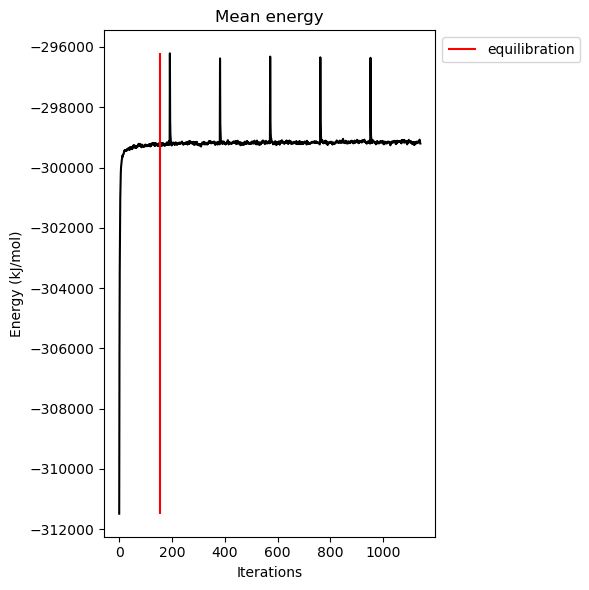

In [5]:
fma.get_average_energy(plot=True);

The following shows the thermodynamic state index of every fifth replicas from the last completed subsimulation.

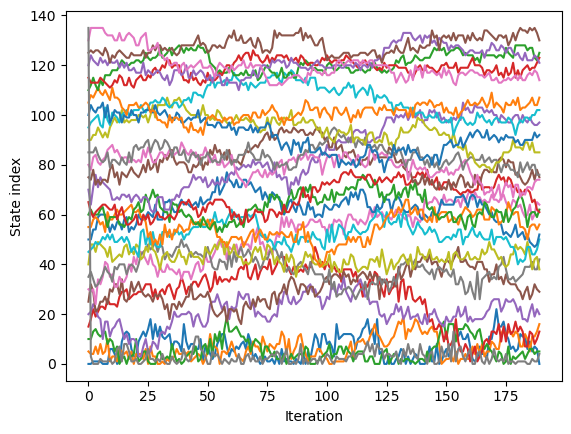

In [6]:
plt.plot(fma.state_inds[-1][:,::5]);
plt.xlabel('Iteration')
plt.ylabel('State index');

--> Does the state index change with the iteration? Why?

The following shows the energy distribution within each thermodynamic state.

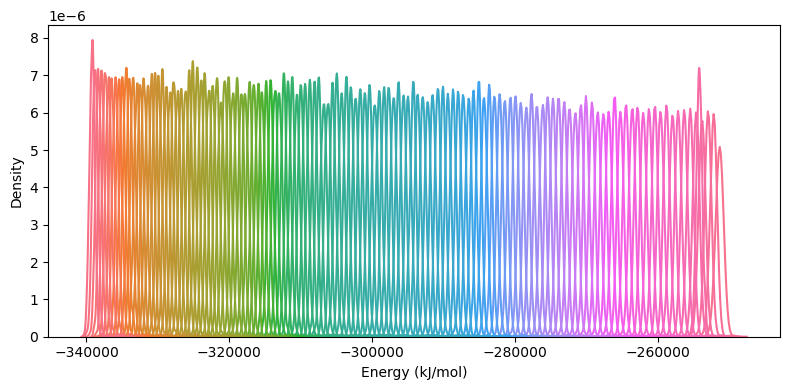

In [7]:
fma.plot_energy_distributions();

--> Does the energy between different temperatures overlap?

The following code plots the box volumes for every 10th thermodynamic state. They should fluctuate and higher temperatures should have larger volumes.

In [8]:
fma.map = np.array(fma.map, dtype=int)
box_vectors = fma._reshape_list(fma.unshaped_box_vectors)
box_volumes = np.zeros((fma.map.shape[0], fma.map.shape[1]))
for iteration in range(fma.map.shape[0]):
    for state in range(fma.map.shape[1]):
        sim_no, sim_iter, sim_rep_ind = fma.map[iteration, state]
        box_volumes[iteration, state] = np.product(np.diag(box_vectors[sim_no][sim_iter, sim_rep_ind]))

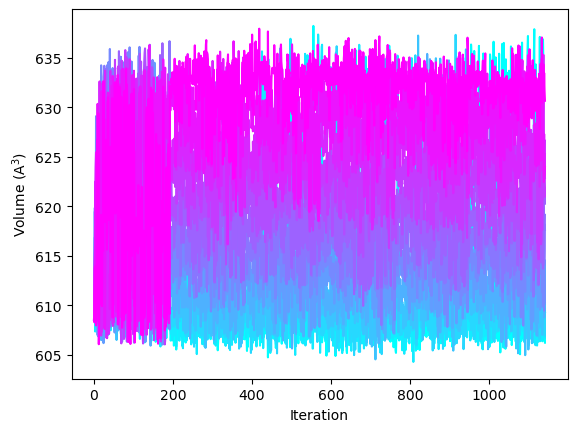

In [9]:
from matplotlib import colormaps
from cycler import cycler

ncolors = int(np.ceil(box_volumes.shape[1]/10.))
cmap = colormaps['cool'].resampled(ncolors)
color_cycle = [cmap(n) for n in range(ncolors)]

fig, ax = plt.subplots()
ax.set_prop_cycle(cycler(color=color_cycle))
plt.plot(box_volumes[:,::10]);
plt.xlabel('Iteration')
plt.ylabel('Volume (A$^3$)');

## Sampling importance resampling

We have learned about importance sampling, where simulations in one state are used to estimate expectation values in other states. In sampling importance resampling, samples are resamples from simulations in other states. We will use sampling importance resampling to select conformations of the complex from multiple replica exchange temperatures.

The following shows the aggregate weight at the lowest temperature of simulations at each temperature.

11/17/2024 22:09:35 // Equilibration detected at 21.8 ns


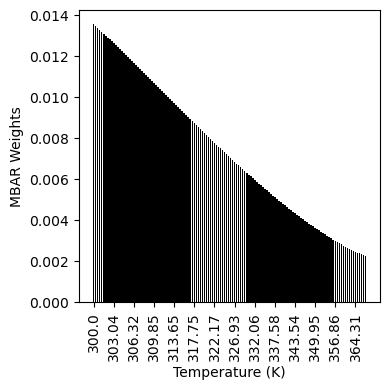

(<Figure size 400x400 with 1 Axes>,
 <Axes: xlabel='Temperature (K)', ylabel='MBAR Weights'>)

In [10]:
fma.resids = None
fma.importance_resampling(equilibration_method='PCA')
# Sum of weights per state
fma.plot_weights()

--> How does the sum of weights vary with temperature? Why?

In [22]:
# View representative frames of the lowest temperature, highest temperature, 
# and resampled from the lowest temperature
nframes = 10

mda_universe = mda.Universe(FN['pdb'])
sel_complex = mda_universe.select_atoms('protein or resname UNK')
mda_complex_universe = mda.Merge(sel_complex)

view = py3Dmol.view(viewergrid=(1,3), linked=True)
for view_index, ensemble in enumerate(['low','high','resampled']):
    if ensemble=='low':
        sim_idx = fma.map[::int(fma.map.shape[0]/nframes+1),0,:]
    elif ensemble=='high':
        sim_idx = fma.map[::int(fma.map.shape[0]/nframes+1),-1,:]
    else:
        sim_idx = [fma.map[iteration, state].astype(int) \
            for (state, iteration) in fma.resampled_inds[:nframes]]
    pos = np.array([fma.positions[s[0]][s[1],s[2],sel_complex.indices] for s in sim_idx])*10

    mda_complex_universe.load_new(pos, format=MemoryReader)
    align.AlignTraj(mobile=mda_complex_universe, reference=mda_complex_universe, \
                    select="protein", in_memory=True).run()

    # Show representative frames of the complex
    with mda.Writer("complex.pdb", multiframe=True) as pdb:
        for ts in mda_complex_universe.trajectory:
            pdb.write(mda_complex_universe)
        pdb.close()
    with open("complex.pdb",'r') as F:
        models = F.read()
        F.close()

    view.addModels(models, viewer=(0, view_index))
    view.setStyle({'model': -1, 'resn':'UNK'}, {"stick": {}}, viewer=(0, view_index))
    view.addStyle({'model': -1}, {"cartoon": {}}, viewer=(0, view_index))
    view.zoomTo(viewer=(0, view_index))
view.show()

/jet/home/dminh/.conda/envs/MDAnalysis/lib/python3.12/site-packages/MDAnalysis/coordinates/PDB.py:777: UserWarning: Unit cell dimensions not found. CRYST1 record set to unitary values.
  warnings.warn("Unit cell dimensions not found. "
/jet/home/dminh/.conda/envs/MDAnalysis/lib/python3.12/site-packages/MDAnalysis/coordinates/PDB.py:1153: UserWarning: Found no information for attr: 'formalcharges' Using default value of '0'
  warnings.warn("Found no information for attr: '{}'"


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

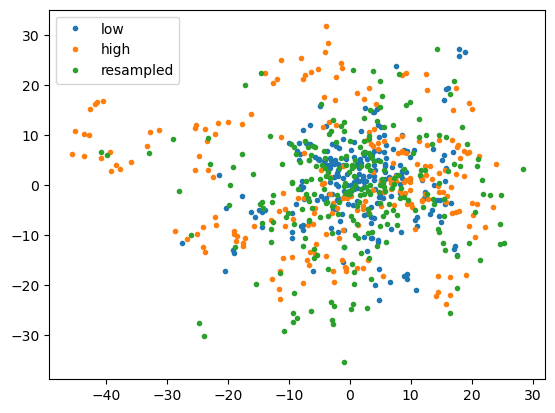

In [74]:
# Principal components analysis based on 100 representative frames from 
# the lowest temperature, highest temperature, and resampled from the lowest temperature
nframes = 250
ensembles = ['low','high','resampled']

mda_universe = mda.Universe(FN['pdb'])
sel_complex = mda_universe.select_atoms('protein or resname UNK')
mda_complex_universe = mda.Merge(sel_complex)
sel_alpha_c = mda_complex_universe.select_atoms('name CA')

positions = {}
for view_index, ensemble in enumerate(ensembles):
    if ensemble=='low':
        sim_idx = fma.map[::int(fma.map.shape[0]/nframes+1),0,:]
    elif ensemble=='high':
        sim_idx = fma.map[::int(fma.map.shape[0]/nframes+1),-1,:]
    else:
        sim_idx = [fma.map[iteration, state].astype(int) \
            for (state, iteration) in fma.resampled_inds[:nframes]]
    pos = np.array([fma.positions[s[0]][s[1],s[2],sel_complex.indices] for s in sim_idx])*10

    mda_complex_universe.load_new(pos, format=MemoryReader)
    align.AlignTraj(mobile=mda_complex_universe, reference=mda_complex_universe, \
                    select="protein", in_memory=True).run()
    positions[ensemble] = mda_complex_universe.trajectory.coordinate_array

# Perform PCA
super_traj = np.vstack([positions[ensemble][:,sel_alpha_c.indices,:].reshape(positions[ensemble].shape[0],-1) \
                        for ensemble in ensembles])
pca = PCA()
reduced_cartesian = pca.fit_transform(super_traj)

# Plot first two principal components
last_inds = np.cumsum([positions[ensemble].shape[0] for ensemble in ensembles])
start_inds = [0] + list(last_inds[:-1])
for start_ind, last_ind in zip(start_inds, last_inds):
    plt.plot(reduced_cartesian[start_ind:last_ind,0],reduced_cartesian[start_ind:last_ind,1],'.')
plt.legend(ensembles);

--> Compare the configuration space sampled at the lower temperature, high temperature, and resampled (at the lower temperature) based on all replicas

Extracting resampled configurations
Aligning configurations
Extracing the ligand
Calculating RMSD matrix


/jet/home/dminh/.conda/envs/MDAnalysis/lib/python3.12/site-packages/MDAnalysis/coordinates/PDB.py:777: UserWarning: Unit cell dimensions not found. CRYST1 record set to unitary values.
  warnings.warn("Unit cell dimensions not found. "
/jet/home/dminh/.conda/envs/MDAnalysis/lib/python3.12/site-packages/MDAnalysis/coordinates/PDB.py:1153: UserWarning: Found no information for attr: 'formalcharges' Using default value of '0'
  warnings.warn("Found no information for attr: '{}'"


[(479, 410), (238, 684), (115, 744), (58, 875), (48, 413), (27, 818), (21, 378), (9, 31), (5, 384)]


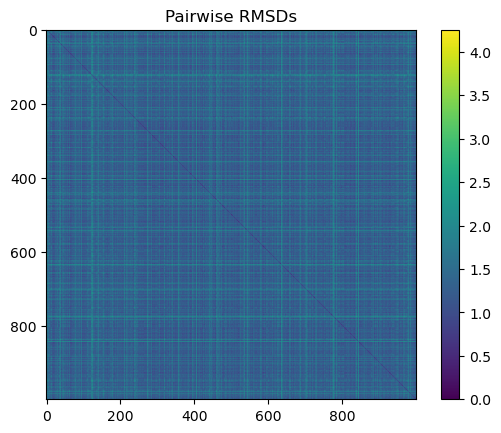

In [77]:
mda_universe = mda.Universe(FN['pdb'])
sel_complex = mda_universe.select_atoms('protein or resname UNK')
mda_complex_universe = mda.Merge(sel_complex)

print('Extracting resampled configurations')
sim_idx = [fma.map[iteration, state].astype(int) \
    for (state, iteration) in fma.resampled_inds]
pos = np.array([fma.positions[s[0]][s[1],s[2],sel_complex.indices] for s in sim_idx])*10
mda_complex_universe.load_new(pos, format=MemoryReader)

print('Aligning configurations')
align.AlignTraj(mobile=mda_complex_universe, reference=mda_complex_universe, \
                select="name CA", in_memory=True).run()
    
print('Extracing the ligand')
sel_ligand = mda_complex_universe.select_atoms('resname UNK and not name H*')
pos_ligand = np.array([ts.positions[sel_ligand.indices,:] for ts in mda_complex_universe.trajectory])
mda_ligand_universe = mda.Merge(sel_ligand)
mda_ligand_universe.load_new(pos_ligand, format=MemoryReader)

# Write a frame of the ligand
with mda.Writer("resampled_ligand.pdb") as pdb:
    pdb.write(mda_ligand_universe)
mol = io.loadmol("resampled_ligand.pdb")

print('Calculating RMSD matrix')
rmsds_sq = np.zeros((pos_ligand.shape[0],pos_ligand.shape[0]))
for j in range(pos_ligand.shape[0]):
    for k in range(j):
        rmsds_sq[j,k] = rmsd.symmrmsd(pos_ligand[j], pos_ligand[k], \
            mol.atomicnums, mol.atomicnums, mol.adjacency_matrix, mol.adjacency_matrix)
        rmsds_sq[k,j] = rmsds_sq[j,k]

plt.imshow(rmsds_sq);
plt.title('Pairwise RMSDs');
plt.colorbar();

# Clustering according to RMSD
rmsds = squareform(rmsds_sq)
Z = scipy.cluster.hierarchy.linkage(rmsds, method='complete')
assignments = np.array(\
  scipy.cluster.hierarchy.fcluster(Z, 2.5, criterion='distance'))

# Create a list of how many frames are in a cluster and the representative frame from each cluster
counts_and_medoids = []
for n in range(1,max(assignments) + 1):
    inds = [i for i in range(len(assignments)) if assignments[i] == n]
    rmsds_n = rmsds_sq[inds][:, inds]
    counts_and_medoids.append((len(inds), inds[np.argmin(np.mean(rmsds_n, 0))]))
counts_and_medoids.sort(reverse=True)

pos_medoids = pos_ligand[[val[1] for val in counts_and_medoids],:,:]
mda_ligand_universe.load_new(pos_medoids, format=MemoryReader)

# Show representative frames of the ligand
with mda.Writer("resampled_ligand.pdb", multiframe=True) as pdb:
    for ts in mda_ligand_universe.trajectory[:25]:
        pdb.write(mda_ligand_universe)
with open("resampled_ligand.pdb",'r') as F:
    models = F.read()

In [104]:
def render(selections):
    view = py3Dmol.view(width=800, height=600)
    view.addModels(models)
    selected_models = [int(selection.split(':')[0]) for selection in selections]
    for selected_model in selected_models:
        view.setStyle({'model':selected_model, 'resn':'UNK'}, {"stick": {}})
    view.zoomTo()
    view.show()
    
interact(render, selections = widgets.SelectMultiple(
    options = [f'{index}: {count}' for index, (count, medoid) in enumerate(counts_and_medoids)],
    value = (f'0: {counts_and_medoids[0][0]}',),
    disabled=False
));

interactive(children=(SelectMultiple(description='selections', index=(0,), options=('0: 479', '1: 238', '2: 11…

--> Compare and contrast your top predicted binding poses